In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import hvplot.pandas
from sklearn.preprocessing import OneHotEncoder
import geopandas as gpd

In [2]:
df = pd.read_csv(r'C:\Users\talha\OneDrive - HKUST Connect\Spring 2023\Visualisation\Project\VAST-Challenge-2022\Datasets\ReducedData\Activity_216.csv')

In [3]:
df.head()

,timestamp,participantId,currentMode,hungerStatus,sleepStatus,apartmentId,availableBalance,jobId,financialStatus,dailyFoodBudget,weeklyExtraBudget,x,y
0,2022-03-01 00:00:00+00:00,216.0,AtHome,JustAte,Sleeping,252.0,1566.249747,964.0,Stable,12.0,652.835643,-745.896344,1639.8869
1,2022-03-01 00:05:00+00:00,216.0,AtHome,JustAte,Sleeping,252.0,1566.249747,964.0,Stable,12.0,652.835643,-745.896344,1639.8869
2,2022-03-01 00:50:00+00:00,216.0,AtHome,BecameFull,Sleeping,252.0,1566.249747,964.0,Stable,12.0,652.835643,-745.896344,1639.8869
3,2022-03-01 03:25:00+00:00,216.0,AtHome,BecomingHungry,Sleeping,252.0,1566.249747,964.0,Stable,12.0,652.835643,-745.896344,1639.8869
4,2022-03-01 05:40:00+00:00,216.0,AtHome,BecomingHungry,Awake,252.0,1566.249747,964.0,Stable,12.0,652.835643,-745.896344,1639.8869


In [72]:
jobs = pd.read_csv(r'C:\Users\talha\OneDrive - HKUST Connect\Spring 2023\Visualisation\Project\VAST-Challenge-2022\Datasets\Attributes\Jobs.csv')
pubs = pd.read_csv(r'C:\Users\talha\OneDrive - HKUST Connect\Spring 2023\Visualisation\Project\VAST-Challenge-2022\Datasets\Attributes\Pubs.csv')
apartments = pd.read_csv(r'C:\Users\talha\OneDrive - HKUST Connect\Spring 2023\Visualisation\Project\VAST-Challenge-2022\Datasets\Attributes\Apartments.csv')
buildings = pd.read_csv(r'C:\Users\talha\OneDrive - HKUST Connect\Spring 2023\Visualisation\Project\VAST-Challenge-2022\Datasets\Attributes\Buildings.csv')
employers = pd.read_csv(r'C:\Users\talha\OneDrive - HKUST Connect\Spring 2023\Visualisation\Project\VAST-Challenge-2022\Datasets\Attributes\Employers.csv')
schools = pd.read_csv(r'C:\Users\talha\OneDrive - HKUST Connect\Spring 2023\Visualisation\Project\VAST-Challenge-2022\Datasets\Attributes\Schools.csv')
restaurants = pd.read_csv(r'C:\Users\talha\OneDrive - HKUST Connect\Spring 2023\Visualisation\Project\VAST-Challenge-2022\Datasets\Attributes\Restaurants.csv')
participants = pd.read_csv(r'C:\Users\talha\OneDrive - HKUST Connect\Spring 2023\Visualisation\Project\VAST-Challenge-2022\Datasets\Attributes\Participants.csv')

In [5]:
jobs.head()

,jobId,employerId,hourlyRate,startTime,endTime,daysToWork,educationRequirement
0,0,379,10.000000,7:46:00 AM,3:46:00 PM,"[Monday,Tuesday,Wednesday,Thursday,Friday]",HighSchoolOrCollege
1,1,379,22.217633,7:31:00 AM,3:31:00 PM,"[Monday,Tuesday,Wednesday,Thursday,Friday]",Bachelors
2,2,380,10.000000,8:00:00 AM,4:00:00 PM,"[Monday,Tuesday,Wednesday,Thursday,Friday]",Bachelors
3,3,380,15.312071,7:39:00 AM,3:39:00 PM,"[Monday,Tuesday,Wednesday,Thursday,Friday]",Bachelors
4,4,381,21.355409,7:53:00 AM,3:53:00 PM,"[Monday,Tuesday,Wednesday,Thursday,Friday]",HighSchoolOrCollege


In [6]:
pubs.head()

,pubId,hourlyCost,maxOccupancy,location,buildingId
0,442,8.281103,64,POINT (964.4380231713202 3991.603473784208),556
1,443,6.417435,64,POINT (1809.880173357865 4339.172426035451),29
2,444,12.581806,84,POINT (770.4279044387976 932.5852003214752),1012
3,892,11.642905,96,POINT (-1524.9573211662105 3815.271490114369),502
4,893,14.840473,79,POINT (-1608.766411449925 3886.4924784954583),164


In [7]:
apartments.head()

,apartmentId,rentalCost,maxOccupancy,numberOfRooms,location,buildingId
0,1,768.16,2,4,POINT (1077.6979444315298 648.4427163702453),340
1,2,1014.55,2,1,POINT (-185.9292838076562 1520.3270983045118),752
2,3,1057.39,4,3,POINT (2123.0141855392585 5126.753457243003),639
3,4,1259.10,4,3,POINT (2103.6301776944765 4266.932930123476),397
4,5,411.50,1,4,POINT (7.0589743819342985 79.96163671849988),628


In [8]:
buildings.head()

,buildingId,location,buildingType,maxOccupancy,units
0,1,"POLYGON ((350.0638997002585 4595.665606173783,...",Commercial,NaN,NaN
1,2,POLYGON ((-1926.972613718425 2725.610686806701...,Residental,12.0,"[481,498,534,652,818]"
2,3,"POLYGON ((685.6846002015491 1552.131491805318,...",Commercial,NaN,[382]
3,4,"POLYGON ((-976.7845160060303 4542.38209636188,...",Commercial,NaN,NaN
4,5,POLYGON ((1259.3061988755617 3572.726728111263...,Residental,2.0,[231]


In [9]:
employers.head()


,employerId,location,buildingId
0,379,POINT (-1849.997168394888 1744.6010147106394),823
1,380,POINT (41.51783767879146 418.7264799744545),154
2,381,POINT (877.2786575380362 1358.5441805909259),279
3,382,POINT (670.3987400004884 1584.4743462106067),3
4,383,POINT (829.9556783260775 2163.4803049897623),146


In [10]:
schools.head()


,schoolId,monthlyCost,maxEnrollment,location,buildingId
0,0,12.812445,242,POINT (-376.7505037068263 1607.9843212558562),662
1,450,91.143514,418,POINT (-2597.447677094323 3194.1547530883445),943
2,900,38.005380,394,POINT (-2539.1584040534744 6556.0323181733565),262
3,1350,73.197852,384,POINT (-4701.462928834322 5141.762936081409),123


In [11]:
restaurants.head()


,restaurantId,foodCost,maxOccupancy,location,buildingId
0,445,5.15,71,POINT (631.5130723031391 2001.4772026036535),304
1,446,4.17,82,POINT (413.840000705876 1194.128694228948),308
2,447,5.87,119,POINT (497.9967937001494 1624.515148185587),58
3,448,4.07,98,POINT (698.2411158717262 4392.416668183332),964
4,449,5.11,53,POINT (1407.7107695149243 4010.4574815269225),181


In [12]:
participants.head()

,participantId,householdSize,haveKids,age,educationLevel,interestGroup,joviality
0,0,3,True,36,HighSchoolOrCollege,H,0.001627
1,1,3,True,25,HighSchoolOrCollege,B,0.328087
2,2,3,True,35,HighSchoolOrCollege,A,0.393470
3,3,3,True,21,HighSchoolOrCollege,I,0.138063
4,4,3,True,43,Bachelors,H,0.857397


- which building has the most offices/employers?
- or which region has the most offices/commercial activity/residential area?
- common education level of people in a region and what kind of jobs and where are their jobs?
- is there a correlation between enrollment in schools and education/income of people in the region?
- which area is expensive/cheap? why? schools, pubs, commercial buildings in proximity?
- can track activity of a single participant to show which routes he/she takes? which areas he frequents (favourite pub etc)?


In [13]:
jobs['educationRequirement'].value_counts().hvplot.bar(
    title="Job Counts", xlabel='Education level', ylabel='Count', 
    width=500, height=350
)

:Bars   [index]   (educationRequirement)

<Axes: xlabel='jobId', ylabel='hourlyRate'>

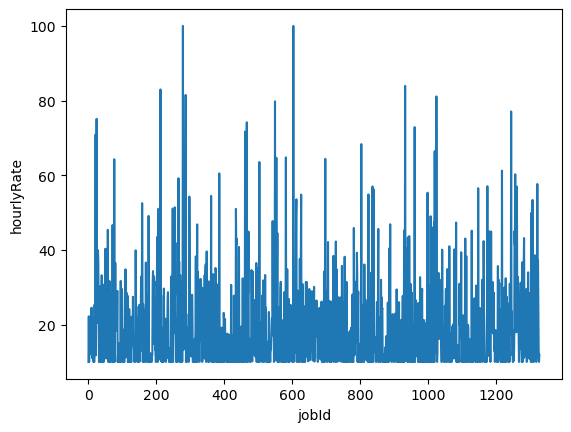

In [14]:
#Distribution of hourly rate for jobs
sns.lineplot(data=jobs, x="jobId", y="hourlyRate")

<Axes: xlabel='educationRequirement', ylabel='hourlyRate'>

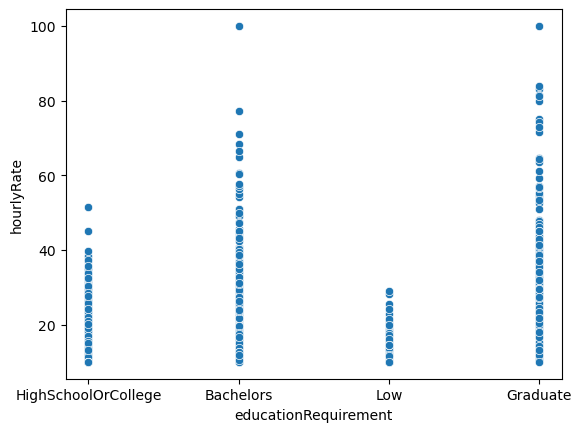

In [15]:
#Relation between hourly rate and education requirement
sns.scatterplot(data=jobs, x="educationRequirement", y="hourlyRate")

<Axes: xlabel='buildingId', ylabel='hourlyCost'>

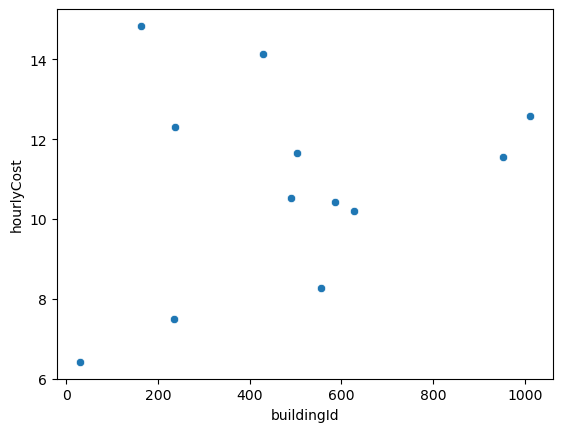

In [16]:
# Which building has the most expensive pub 
sns.scatterplot(data=pubs, x="buildingId", y="hourlyCost")

<Axes: xlabel='buildingId', ylabel='rentalCost'>

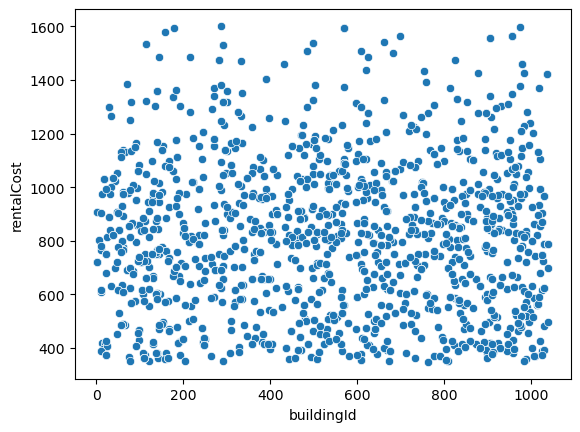

In [17]:
#Which apartment building has the highest rent
sns.scatterplot(data=apartments, x="buildingId", y="rentalCost")

### Journals

In [87]:
restaurants.head(21)


,restaurantId,foodCost,maxOccupancy,location,buildingId
0,445,5.15,71,POINT (631.5130723031391 2001.4772026036535),304
1,446,4.17,82,POINT (413.840000705876 1194.128694228948),308
2,447,5.87,119,POINT (497.9967937001494 1624.515148185587),58
3,448,4.07,98,POINT (698.2411158717262 4392.416668183332),964
4,449,5.11,53,POINT (1407.7107695149243 4010.4574815269225),181
5,895,4.44,103,POINT (-1623.0740591441258 3872.0300113645017),164
6,896,5.86,107,POINT (-2126.1723943111892 4285.182228265561),619
7,897,5.76,104,POINT (-1989.63526350385 3368.764837974986),875
8,898,4.22,115,POINT (-1771.452216635636 4343.580176583138),917
9,899,5.65,85,POINT (-820.9290279479601 4497.243308530136),86


In [71]:
pubs.head(12)

,pubId,hourlyCost,maxOccupancy,location,buildingId,latitude,longitude,pubId1
0,44.2,8.281103,64,POINT (964.4380231713202 3991.603473784208),5.56,964.438023,3991.603474,4.42
1,44.3,6.417435,64,POINT (1809.880173357865 4339.172426035451),0.29,1809.880173,4339.172426,4.43
2,44.4,12.581806,84,POINT (770.4279044387976 932.5852003214752),10.12,770.427904,932.585200,4.44
3,89.2,11.642905,96,POINT (-1524.9573211662105 3815.271490114369),5.02,-1524.957321,3815.271490,8.92
4,89.3,14.840473,79,POINT (-1608.766411449925 3886.4924784954583),1.64,-1608.766411,3886.492478,8.93
5,89.4,12.311210,72,POINT (-1702.5378155541193 3865.477090848479),2.38,-1702.537816,3865.477091,8.94
6,134.2,14.140037,77,POINT (-260.45747053139064 5026.150804179361),4.29,-260.457471,5026.150804,13.42
7,134.3,10.524972,67,POINT (-501.42676062779447 3551.572638649489),4.89,-501.426761,3551.572639,13.43
8,134.4,10.415293,60,POINT (-225.9209866450221 3878.053697626113),5.85,-225.920987,3878.053698,13.44
9,179.8,11.545351,64,POINT (-3209.738139187618 6487.657688065099),9.53,-3209.738139,6487.657688,17.98


In [25]:
# pubs.loc[["pubId"]]==442

In [73]:
def processLocation(df):
    """
    :params df: dataframe
    :params alias:columns alias thats in COL_MAP
    :params colstoset:keyss from LOCATION_COLS map
    """
    df['latitude'] = pd.Series(df['location']).str.extract(r'([-]*[0-9]+\.[0-9]+)')
    df['longitude'] = pd.Series(df['location']).str.extract(r'(\s[0-9]+\.[0-9]+)')
    df['longitude'] = pd.Series(df['longitude']).str.strip()
    df['latitude'] = df['latitude'].astype(float)
    df['longitude'] = df['longitude'].astype(float)
    return df

In [74]:
# pubs.shape

In [75]:
pubs_processed = processLocation(pubs)

In [76]:
pubs_processed.head(12)

,pubId,hourlyCost,maxOccupancy,location,buildingId,latitude,longitude
0,442,8.281103,64,POINT (964.4380231713202 3991.603473784208),556,964.438023,3991.603474
1,443,6.417435,64,POINT (1809.880173357865 4339.172426035451),29,1809.880173,4339.172426
2,444,12.581806,84,POINT (770.4279044387976 932.5852003214752),1012,770.427904,932.585200
3,892,11.642905,96,POINT (-1524.9573211662105 3815.271490114369),502,-1524.957321,3815.271490
4,893,14.840473,79,POINT (-1608.766411449925 3886.4924784954583),164,-1608.766411,3886.492478
5,894,12.311210,72,POINT (-1702.5378155541193 3865.477090848479),238,-1702.537816,3865.477091
6,1342,14.140037,77,POINT (-260.45747053139064 5026.150804179361),429,-260.457471,5026.150804
7,1343,10.524972,67,POINT (-501.42676062779447 3551.572638649489),489,-501.426761,3551.572639
8,1344,10.415293,60,POINT (-225.9209866450221 3878.053697626113),585,-225.920987,3878.053698
9,1798,11.545351,64,POINT (-3209.738139187618 6487.657688065099),953,-3209.738139,6487.657688


In [76]:
# pubs_processed.to_csv("pubs_processed.csv")

In [77]:
pubs_processed["latitude"]=pubs_processed["latitude"].apply(lambda x: x*-1 if x<0 else x*1)

In [78]:
pubs_processed["latitude"] = pubs_processed["latitude"].apply(lambda x: x/10.0)

In [79]:
pubs_processed["longitude"] = pubs_processed["longitude"].apply(lambda x: x/10.0)
pubs_processed["pubId1"] = pubs_processed["pubId"].apply(lambda x: x/10.0)
pubs_processed["buildingId"] = pubs_processed["buildingId"].apply(lambda x: x/10.0)

In [80]:
pubs_processed["longitude"] = pubs_processed["longitude"].apply(lambda x: x/10.0)

In [81]:
pubs_processed.head(12)

,pubId,hourlyCost,maxOccupancy,location,buildingId,latitude,longitude,pubId1
0,442,8.281103,64,POINT (964.4380231713202 3991.603473784208),55.6,96.443802,39.916035,44.2
1,443,6.417435,64,POINT (1809.880173357865 4339.172426035451),2.9,180.988017,43.391724,44.3
2,444,12.581806,84,POINT (770.4279044387976 932.5852003214752),101.2,77.042790,9.325852,44.4
3,892,11.642905,96,POINT (-1524.9573211662105 3815.271490114369),50.2,152.495732,38.152715,89.2
4,893,14.840473,79,POINT (-1608.766411449925 3886.4924784954583),16.4,160.876641,38.864925,89.3
5,894,12.311210,72,POINT (-1702.5378155541193 3865.477090848479),23.8,170.253782,38.654771,89.4
6,1342,14.140037,77,POINT (-260.45747053139064 5026.150804179361),42.9,26.045747,50.261508,134.2
7,1343,10.524972,67,POINT (-501.42676062779447 3551.572638649489),48.9,50.142676,35.515726,134.3
8,1344,10.415293,60,POINT (-225.9209866450221 3878.053697626113),58.5,22.592099,38.780537,134.4
9,1798,11.545351,64,POINT (-3209.738139187618 6487.657688065099),95.3,320.973814,64.876577,179.8


In [82]:
pubs_processed.to_csv("pubs_processed_radar.csv")

In [46]:
X = pubs_processed[['pubId', 'hourlyCost', 'maxOccupancy', 'buildingId', 'latitude', 'longitude']].values

In [47]:
X.shape

(12, 6)

In [49]:
X = (X - X.mean()) / X.std()

In [51]:
X[0]

array([-0.49795391, -0.75367638, -0.72082428, -0.43073904, -0.18992229,
        1.59490702])

In [22]:
checkin = pd.read_csv(r'C:\Users\talha\OneDrive - HKUST Connect\Spring 2023\Visualisation\Project\VAST-Challenge-2022\Datasets\Journals\CheckinJournal.csv')
financial = pd.read_csv(r'C:\Users\talha\OneDrive - HKUST Connect\Spring 2023\Visualisation\Project\VAST-Challenge-2022\Datasets\Journals\FinancialJournal.csv')
social = pd.read_csv(r'C:\Users\talha\OneDrive - HKUST Connect\Spring 2023\Visualisation\Project\VAST-Challenge-2022\Datasets\Journals\SocialNetwork.csv')
travel = pd.read_csv(r'C:\Users\talha\OneDrive - HKUST Connect\Spring 2023\Visualisation\Project\VAST-Challenge-2022\Datasets\Journals\TravelJournal.csv')

In [23]:
checkin.head()

,participantId,timestamp,venueId,venueType
0,619,2022-03-01T05:35:00Z,1798,Pub
1,15,2022-03-01T05:50:00Z,1798,Pub
2,23,2022-03-01T05:55:00Z,894,Pub
3,699,2022-03-01T06:00:00Z,1798,Pub
4,876,2022-03-01T06:00:00Z,1804,Restaurant


In [24]:
checkin_pub = checkin.loc[checkin['venueType'] == 'Pub']

In [25]:
checkin_pub.query("venueId == 894").groupby(["venueId"]).sum()

C:\Users\talha\AppData\Local\Temp\ipykernel_34000\1901797971.py:1: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  checkin_pub.query("venueId == 894").groupby(["venueId"]).sum()


,participantId
venueId,
894,9944752


In [26]:
checkin_rest = checkin.loc[checkin['venueType'] == 'Restaurant']

In [27]:
print("pub: ",checkin_pub["timestamp"].min())
print("pub: ",checkin_pub["timestamp"].max())
print("rest: ",checkin_rest["timestamp"].min())
print("rest: ",checkin_rest["timestamp"].max())

pub:  2022-03-01T05:35:00Z
pub:  2023-05-25T00:05:00Z
rest:  2022-03-01T06:00:00Z
rest:  2023-05-24T23:55:00Z


In [28]:
from datetime import date
# date(checkin_pub["timestamp"][0])

In [29]:
print(checkin_pub['venueId'].unique()) # 12 unique pubs were checked in
print(checkin_rest['venueId'].unique()) # 20 restaurants were checked in


[1798  894  893  892 1799  443 1342 1344 1343  442 1800  444]
[1804  895  446 1801 1348 1802 1803 1347 1345 1805  897  899  449 1346
  448  445  447  896  898 1349]


In [30]:
checkin_pub["year"] = checkin_pub['timestamp'].apply(lambda x: x[:4])
checkin_pub["month"] = checkin_pub['timestamp'].apply(lambda x: x[5:7])
checkin_pub["day"] = checkin_pub['timestamp'].apply(lambda x: x[8:10])
checkin_pub["hour"] = checkin_pub['timestamp'].apply(lambda x: x[11:13])
checkin_pub["min"] = checkin_pub['timestamp'].apply(lambda x: x[14:16])
checkin_pub["date"] = checkin_pub['timestamp'].apply(lambda x: x[:10])

C:\Users\talha\AppData\Local\Temp\ipykernel_34000\1526095304.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  checkin_pub["year"] = checkin_pub['timestamp'].apply(lambda x: x[:4])
C:\Users\talha\AppData\Local\Temp\ipykernel_34000\1526095304.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  checkin_pub["month"] = checkin_pub['timestamp'].apply(lambda x: x[5:7])
C:\Users\talha\AppData\Local\Temp\ipykernel_34000\1526095304.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice fro

In [31]:
checkin_pub.tail()

,participantId,timestamp,venueId,venueType,year,month,day,hour,min,date
2100619,125,2023-05-24T23:55:00Z,894,Pub,2023,05,24,23,55,2023-05-24
2100623,576,2023-05-24T23:55:00Z,444,Pub,2023,05,24,23,55,2023-05-24
2100625,931,2023-05-24T23:55:00Z,1799,Pub,2023,05,24,23,55,2023-05-24
2100628,299,2023-05-25T00:00:00Z,894,Pub,2023,05,25,00,00,2023-05-25
2100634,912,2023-05-25T00:05:00Z,1800,Pub,2023,05,25,00,05,2023-05-25


In [32]:
checkin_rest["year"] = checkin_rest['timestamp'].apply(lambda x: x[:4])
checkin_rest["month"] = checkin_rest['timestamp'].apply(lambda x: x[5:7])
checkin_rest["day"] = checkin_rest['timestamp'].apply(lambda x: x[8:10])
checkin_rest["hour"] = checkin_rest['timestamp'].apply(lambda x: x[11:13])
checkin_rest["min"] = checkin_rest['timestamp'].apply(lambda x: x[14:16])
checkin_rest["date"] = checkin_rest['timestamp'].apply(lambda x: x[:10])
checkin_rest.head()

C:\Users\talha\AppData\Local\Temp\ipykernel_34000\2897641523.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  checkin_rest["year"] = checkin_rest['timestamp'].apply(lambda x: x[:4])
C:\Users\talha\AppData\Local\Temp\ipykernel_34000\2897641523.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  checkin_rest["month"] = checkin_rest['timestamp'].apply(lambda x: x[5:7])
C:\Users\talha\AppData\Local\Temp\ipykernel_34000\2897641523.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice

,participantId,timestamp,venueId,venueType,year,month,day,hour,min,date
4,876,2022-03-01T06:00:00Z,1804,Restaurant,2022,03,01,06,00,2022-03-01
5,23,2022-03-01T06:05:00Z,895,Restaurant,2022,03,01,06,05,2022-03-01
6,154,2022-03-01T06:10:00Z,446,Restaurant,2022,03,01,06,10,2022-03-01
8,509,2022-03-01T06:10:00Z,1801,Restaurant,2022,03,01,06,10,2022-03-01
9,556,2022-03-01T06:10:00Z,1348,Restaurant,2022,03,01,06,10,2022-03-01


In [33]:
test_df =pd.read_csv("https://raw.githubusercontent.com/leoyuholo/learning-vis-tools/master/tutorial09/lab9/spotify-daily-global-song-ranking-2017.csv")

In [34]:
type(test_df["Date"])

pandas.core.series.Series

In [35]:
checkin_rest.filter(like='1804',axis=0).groupby(['date']).count()

,participantId,timestamp,venueId,venueType,year,month,day,hour,min
date,,,,,,,,,
2022-03-01,1,1,1,1,1,1,1,1,1
2022-03-02,1,1,1,1,1,1,1,1,1
2022-03-03,1,1,1,1,1,1,1,1,1
2022-03-18,3,3,3,3,3,3,3,3,3
2022-03-30,1,1,1,1,1,1,1,1,1
...,...,...,...,...,...,...,...,...,...
2023-04-23,1,1,1,1,1,1,1,1,1
2023-04-30,1,1,1,1,1,1,1,1,1
2023-05-06,2,2,2,2,2,2,2,2,2


In [38]:
checkin_rest['count']=1

C:\Users\talha\AppData\Local\Temp\ipykernel_34000\9667746.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  checkin_rest['count']=1


In [39]:
checkin_rest.head()

,participantId,timestamp,venueId,venueType,year,month,day,hour,min,date,count
4,876,2022-03-01T06:00:00Z,1804,Restaurant,2022,03,01,06,00,2022-03-01,1
5,23,2022-03-01T06:05:00Z,895,Restaurant,2022,03,01,06,05,2022-03-01,1
6,154,2022-03-01T06:10:00Z,446,Restaurant,2022,03,01,06,10,2022-03-01,1
8,509,2022-03-01T06:10:00Z,1801,Restaurant,2022,03,01,06,10,2022-03-01,1
9,556,2022-03-01T06:10:00Z,1348,Restaurant,2022,03,01,06,10,2022-03-01,1


In [93]:
checkin_rest.to_csv("rest_checkin.csv")

In [96]:
checkin_rest["venueId"].unique()

array([1804,  895,  446, 1801, 1348, 1802, 1803, 1347, 1345, 1805,  897,
        899,  449, 1346,  448,  445,  447,  896,  898, 1349], dtype=int64)

In [21]:
financial.head()

,participantId,timestamp,category,amount
0,0,2022-03-01T00:00:00Z,Wage,2472.507559
1,0,2022-03-01T00:00:00Z,Shelter,-554.988622
2,0,2022-03-01T00:00:00Z,Education,-38.005380
3,1,2022-03-01T00:00:00Z,Wage,2046.562206
4,1,2022-03-01T00:00:00Z,Shelter,-554.988622


In [22]:
social.head()

,timestamp,participantIdFrom,participantIdTo
0,2022-03-01T00:00:00Z,173,180
1,2022-03-01T00:00:00Z,178,183
2,2022-03-01T00:00:00Z,178,185
3,2022-03-01T00:00:00Z,180,173
4,2022-03-01T00:00:00Z,183,178


In [23]:
travel.head()

,participantId,travelStartTime,travelStartLocationId,travelEndTime,travelEndLocationId,purpose,checkInTime,checkOutTime,startingBalance,endingBalance
0,23,2022-03-01T05:20:00Z,532.0,2022-03-01T05:55:00Z,894,Recreation (Social Gathering),2022-03-01T05:55:00Z,2022-03-01T06:00:00Z,851.223425,850.197491
1,876,2022-03-01T05:50:00Z,NaN,2022-03-01T06:00:00Z,1804,Eating,2022-03-01T06:00:00Z,2022-03-01T06:05:00Z,2071.779647,2065.864612
2,902,2022-03-01T06:05:00Z,NaN,2022-03-01T06:10:00Z,1801,Eating,2022-03-01T06:10:00Z,2022-03-01T06:15:00Z,2115.790341,2110.280842
3,919,2022-03-01T06:00:00Z,NaN,2022-03-01T06:10:00Z,1802,Eating,2022-03-01T06:10:00Z,2022-03-01T06:15:00Z,2120.433773,2115.351009
4,154,2022-03-01T05:55:00Z,NaN,2022-03-01T06:10:00Z,446,Eating,2022-03-01T06:10:00Z,2022-03-01T06:15:00Z,2246.247936,2242.074591


In [24]:
travel['startingBalance-endingBalance']=travel['startingBalance']-travel['endingBalance']

In [25]:
travel.head()

,participantId,travelStartTime,travelStartLocationId,travelEndTime,travelEndLocationId,purpose,checkInTime,checkOutTime,startingBalance,endingBalance,startingBalance-endingBalance
0,23,2022-03-01T05:20:00Z,532.0,2022-03-01T05:55:00Z,894,Recreation (Social Gathering),2022-03-01T05:55:00Z,2022-03-01T06:00:00Z,851.223425,850.197491,1.025934
1,876,2022-03-01T05:50:00Z,NaN,2022-03-01T06:00:00Z,1804,Eating,2022-03-01T06:00:00Z,2022-03-01T06:05:00Z,2071.779647,2065.864612,5.915035
2,902,2022-03-01T06:05:00Z,NaN,2022-03-01T06:10:00Z,1801,Eating,2022-03-01T06:10:00Z,2022-03-01T06:15:00Z,2115.790341,2110.280842,5.509499
3,919,2022-03-01T06:00:00Z,NaN,2022-03-01T06:10:00Z,1802,Eating,2022-03-01T06:10:00Z,2022-03-01T06:15:00Z,2120.433773,2115.351009,5.082764
4,154,2022-03-01T05:55:00Z,NaN,2022-03-01T06:10:00Z,446,Eating,2022-03-01T06:10:00Z,2022-03-01T06:15:00Z,2246.247936,2242.074591,4.173345


In [26]:
sns.set(rc={"figure.figsize":(20, 12)})

In [27]:
sns.scatterplot(data=travel, x="participantId", y="startingBalance-endingBalance", hue="purpose")

<Axes: xlabel='participantId', ylabel='startingBalance-endingBalance'>

Error in callback <function _draw_all_if_interactive at 0x00000133300875E0> (for post_execute):


KeyboardInterrupt: 

Error in callback <function flush_figures at 0x00000133379A9E50> (for post_execute):


KeyboardInterrupt: 

In [28]:
build = gpd.read_file(r'C:\Users\talha\OneDrive - HKUST Connect\Spring 2023\Visualisation\Project\VAST-Challenge-2022\Datasets\Attributes\Buildings.csv')

In [29]:
build.head()

,buildingId,location,buildingType,maxOccupancy,units,geometry
0,1,"POLYGON ((350.0638997002585 4595.665606173783,...",Commercial,,,None
1,2,POLYGON ((-1926.972613718425 2725.610686806701...,Residental,12,"[481,498,534,652,818]",None
2,3,"POLYGON ((685.6846002015491 1552.131491805318,...",Commercial,,[382],None
3,4,"POLYGON ((-976.7845160060303 4542.38209636188,...",Commercial,,,None
4,5,POLYGON ((1259.3061988755617 3572.726728111263...,Residental,2,[231],None


In [30]:
ax= build.plot(column='location', figsize=(10,6), edgecolor='black', legend=True)

In [31]:
build.to_file("city.geojson", driver="GeoJSON")

In [32]:
build1 = gpd.read_file("./city.geojson")

In [33]:
build1.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [34]:
build1.head()


,buildingId,location,buildingType,maxOccupancy,units,geometry
0,1,"POLYGON ((350.0638997002585 4595.665606173783,...",Commercial,,,None
1,2,POLYGON ((-1926.972613718425 2725.610686806701...,Residental,12,"[ 481, 498, 534, 652, 818 ]",None
2,3,"POLYGON ((685.6846002015491 1552.131491805318,...",Commercial,,[ 382 ],None
3,4,"POLYGON ((-976.7845160060303 4542.38209636188,...",Commercial,,,None
4,5,POLYGON ((1259.3061988755617 3572.726728111263...,Residental,2,[ 231 ],None


C:\Users\talha\anaconda3\envs\viz\lib\site-packages\geopandas\array.py:938: RuntimeWarning: All-NaN slice encountered
  np.nanmin(b[:, 0]),  # minx
C:\Users\talha\anaconda3\envs\viz\lib\site-packages\geopandas\array.py:939: RuntimeWarning: All-NaN slice encountered
  np.nanmin(b[:, 1]),  # miny
C:\Users\talha\anaconda3\envs\viz\lib\site-packages\geopandas\array.py:940: RuntimeWarning: All-NaN slice encountered
  np.nanmax(b[:, 2]),  # maxx
C:\Users\talha\anaconda3\envs\viz\lib\site-packages\geopandas\array.py:941: RuntimeWarning: All-NaN slice encountered
  np.nanmax(b[:, 3]),  # maxy


ValueError: aspect must be finite and positive 

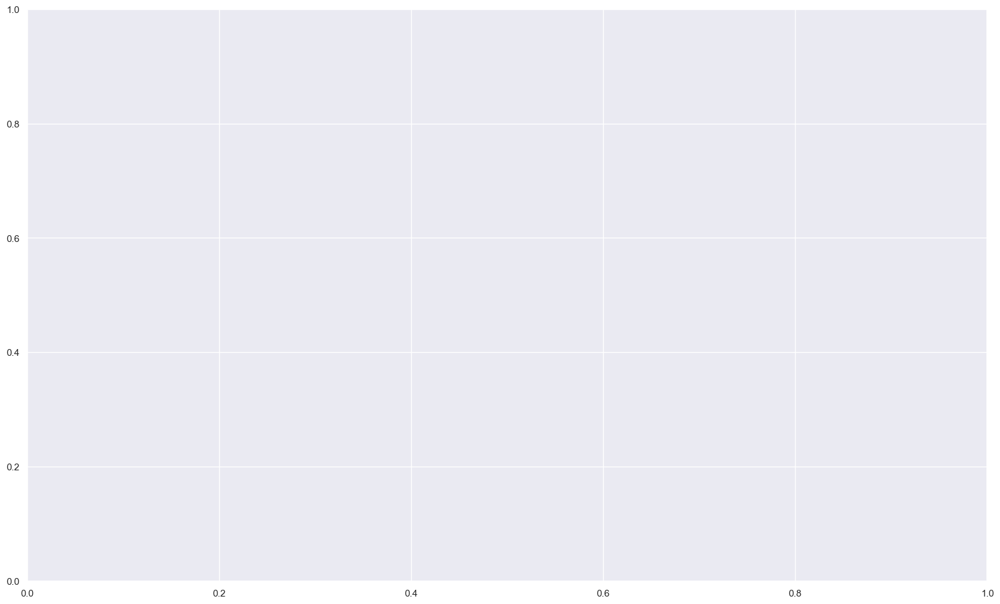

In [35]:
ax= build1.plot()

In [ ]:
educationRequirement = pd.get_dummies(jobs.educationRequirement)
jobs1 = jobs
jobs1.drop(columns=['daysToWork','jobId','employerId','startTime','endTime'],inplace=True)
jobs1['educationRequirement']=educationRequirement
jobs1.head()

In [ ]:
corrmat = jobs1.corr()
top_corr = corrmat.index
plt.figure(figsize=(20,20))
pl = sns.heatmap(jobs1[top_corr].corr(), annot=True, cmap="RdYlGn")

In [ ]:
jobs1.tail()

In [ ]:
flights = sns.load_dataset("flights")
flights.head()


In [ ]:
may_flights = flights.query("month == 'May'")
sns.lineplot(data=may_flights, x="year", y="passengers")

In [ ]:
may_flights.head()

In [ ]:
flights.groupby(['year']).mean()

In [ ]:
flights.groupby(['year']).sum()